In [14]:
import cv2
import os
import config
import math
import numpy as np
import tensorflow as tf
from tensorflow import keras
from PIL import Image, ImageFont, ImageDraw  
import skimage.data
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import selectivesearch
from skimage.io import imread, imsave, imshow
from skimage import data, color, io, filters, morphology,transform, exposure, feature, util

from keras.models import load_model 
from keras.preprocessing import image
from keras.preprocessing.image import img_to_array, load_img

###### Voor Tensorflow-GPU ########
physical_devices = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], True)

# Research Project - De Bakker Luka

## Hoe kan facial recognition toegepast worden op manga?

## Wat is manga?

![](https://i.imgur.com/IaBryRF.jpg) ![](https://i.imgur.com/o6rFjaw.jpg?1)

![](https://i.imgur.com/uxpvflC.png?1) ![](https://i.imgur.com/XeSrEkF.jpg?1)

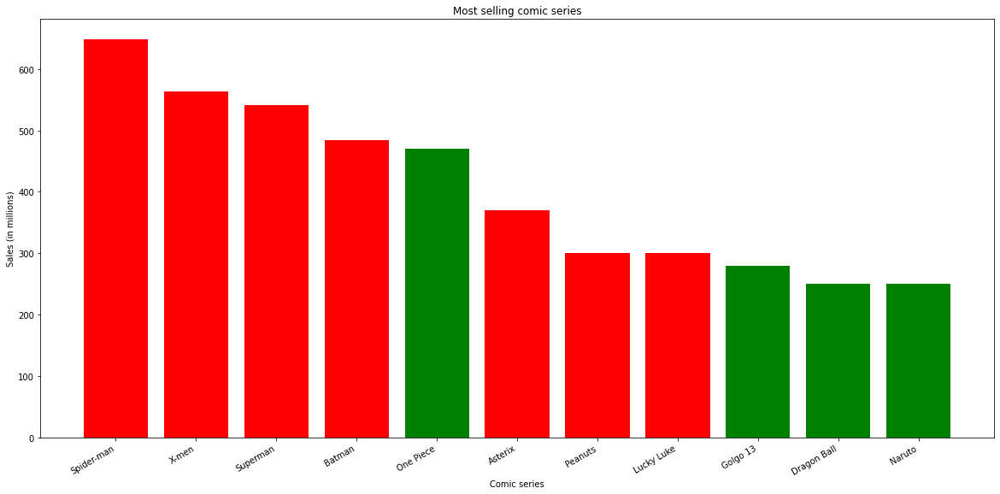

In [5]:
# libraries
import numpy as np
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(20,10))
plt.title("Most selling comic series")
plt.ylabel("Sales (in millions)")
plt.xlabel("Comic series")
height = [649, 563, 541, 484, 470, 370, 300, 300, 280,  250, 250]
bars = ('Spider-man', 'X-men', 'Superman', 'Batman', 'One Piece', 'Asterix', 'Peanuts', 'Lucky Luke', 'Golgo 13', 'Dragon Ball', 'Naruto')
y_pos = np.arange(len(bars))

fig.autofmt_xdate() # make space for and rotate the x-axis tick labels
plt.bar(y_pos, height, color=['red', 'red', 'red', 'red','green', 'red', 'red', 'red', 'green', 'green', 'green'])
plt.xticks(y_pos, bars)
plt.show()

![](https://i.imgur.com/ZHo5Z4U.png)

![Tezuka](https://j.gifs.com/jZXy4B.gif "tezuka")

## Oplossing

![](https://i.imgur.com/EMXDEmY.png)

## Research

![](https://i.imgur.com/ACvP3Lr.png?1)
![](https://i.imgur.com/JPtMvH7.png?1)

## Detection

### What did I test?
1. AnimeFace XML

2. CNN

3. YOLO models

    3.1. Tiny   
    3.2. SPP

In [7]:
# 1. AnimeFace XMl
def detect(file,files, images, cascade_file = "./lbpcascade_animeface.xml"):
    if not os.path.isfile(cascade_file):
        raise RuntimeError("%s: not found" % cascade_file)

    cascade = cv2.CascadeClassifier(cascade_file)
    image = cv2.imread(images + "/" + file, cv2.IMREAD_COLOR)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.equalizeHist(gray)
    
    faces = cascade.detectMultiScale(gray,
                                     # detector options
                                     scaleFactor = 1.1,
                                     minNeighbors = 5,
                                     minSize = (24, 24))
    for (x, y, w, h) in faces:
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 0, 255), 2)

    return image

# 2. YOLO
# Yolo model inladen en klaarzetten voor gebruik
net = cv2.dnn.readNet("weights_detec/manga_v7_final_weights.weights", "weights_detec/manga_v7_final_config.cfg")  # weight en configuration file ophalen
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]

# Namen van de classes definiëren (volgorde is zeer belangrijk)
classes = ["RandomFrame", "Face", "Text"]

def detect_yolo_spp(file, files, directory):

    img = cv2.imread(directory + "/" +  file)

    img = np.array(img)

    stacked_img = np.stack((img,)*3, axis=-1)

    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)

    class_ids, confidences, boxes = [], [], []
            
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.2:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    # boxes tekenen
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            confidence = round(confidences[i] * 100, 1)
            label = str(classes[int(class_ids[i])])
            cv2.rectangle(img, (x, y), (x + w, y + h), color=(211, 44, 44), thickness=3)
            cv2.putText(img, str(confidence), (x + 5, y + 30), cv2.FONT_HERSHEY_PLAIN, 2, color=(211, 44, 44), thickness=4)

    image = Image.fromarray(img)
    return image




def detect_yolo_tiny(file, files, directory):
    # Yolo model inladen en klaarzetten voor gebruik
    net_tiny = cv2.dnn.readNet("weights_detec/manga_final_weights.weights", "weights_detec/manga_final_config.cfg")  # weight en configuration file ophalen
    layer_names = net_tiny.getLayerNames()
    output_layers = [layer_names[i[0] - 1] for i in net_tiny.getUnconnectedOutLayers()]

    # Namen van de classes definiëren (volgorde is zeer belangrijk)
    classes = ["RandomFrame", "Face", "Text"]
    img = cv2.imread(directory + "/" +  file)

    img = np.array(img)

    stacked_img = np.stack((img,)*3, axis=-1)

    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net_tiny.setInput(blob)
    outs = net_tiny.forward(output_layers)

    class_ids, confidences, boxes = [], [], []
            
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.2:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    # boxes tekenen
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            confidence = round(confidences[i] * 100, 1)
            label = str(classes[int(class_ids[i])])
            cv2.rectangle(img, (x, y), (x + w, y + h), color=(211, 44, 44), thickness=3)
            cv2.putText(img, str(confidence), (x + 5, y + 30), cv2.FONT_HERSHEY_PLAIN, 2, color=(211, 44, 44), thickness=4)

    image = Image.fromarray(img)
    return image

Which volume of manga would you like to use detection on?
 	 0. - Demo Showcase detection -
 	 1. - Demo Showcase recognition horimiya -
 	 2. - Demo Showcase recognition onepiece -
 	 3. Beastars v01
 	 4. Blue Spring Ride - Volume 02.cbz.zip
 	 5. Blue Spring Ride - Volume 03.cbz.zip
 	 6. Blue Spring Ride - Volume 04.cbz.zip
 	 7. Horimiya v01 (2015) (Digital) (LuCaZ).cbz.zip
 	 8. Horimiya v02 (2016) (Digital) (LuCaZ).cbz.zip
 	 9. Horimiya v03 (2016) (Digital) (LuCaZ).cbz.zip
 	 10. Horimiya v04 (2016) (Digital) (LuCaZ).cbz.zip
 	 11. Horimiya v05 (2016) (Digital) (LuCaZ).cbz.zip
 	 12. Horimiya v06 (2017) (Digital) (LuCaZ).cbz.zip
 	 13. Horimiya v07 (2017) (Digital) (LuCaZ).cbz.zip
 	 14. Horimiya v08 (2017) (Digital) (LuCaZ).cbz.zip
 	 15. Horimiya v09 (2017) (Digital) (LuCaZ).cbz.zip
 	 16. Horimiya v10 (2018) (Digital) (LuCaZ).cbz.zip
 	 17. One Piece 01.cbz.zip
 	 18. One Piece 02.cbz.zip
 	 19. One Piece 03.cbz.zip
 	 20. One Piece 04.cbz.zip
 	 21. One Piece 05.cbz.zip
 	 

<Figure size 5760x2880 with 0 Axes>

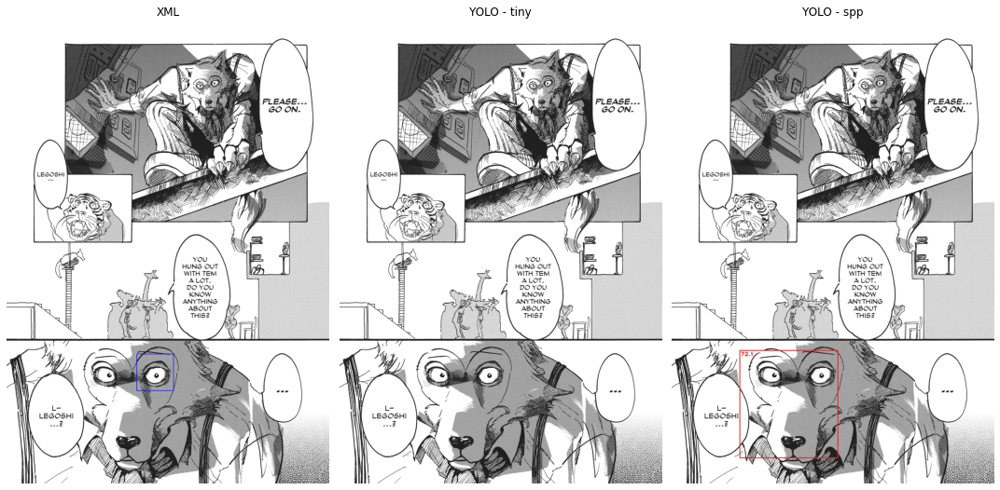

<Figure size 5760x2880 with 0 Axes>

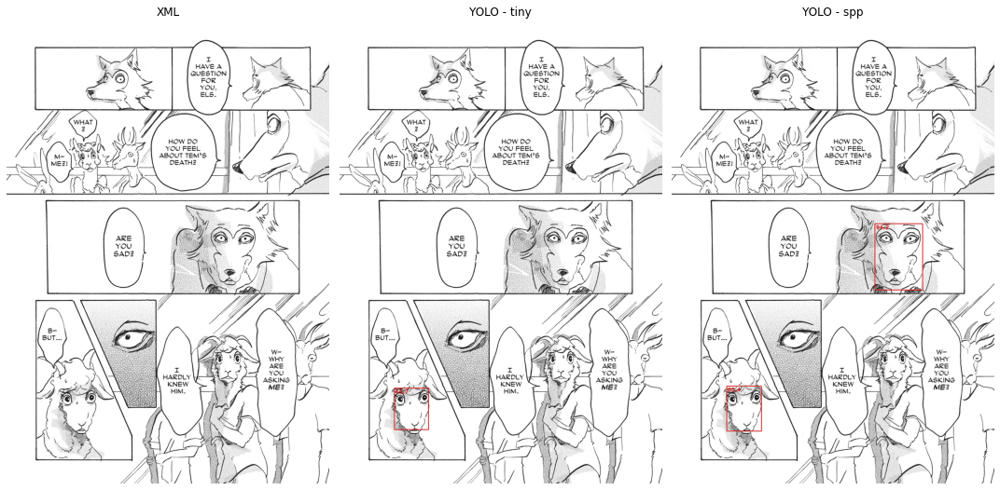

<Figure size 5760x2880 with 0 Axes>

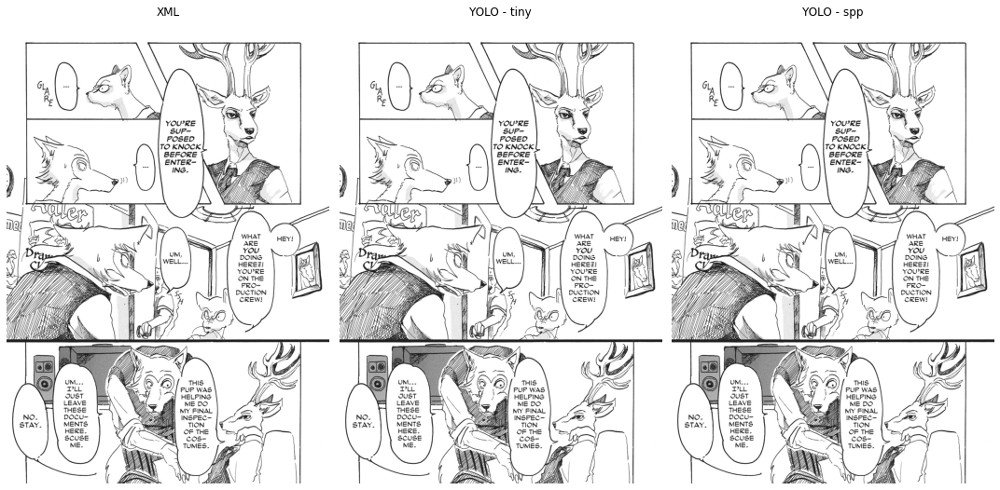

<Figure size 5760x2880 with 0 Axes>

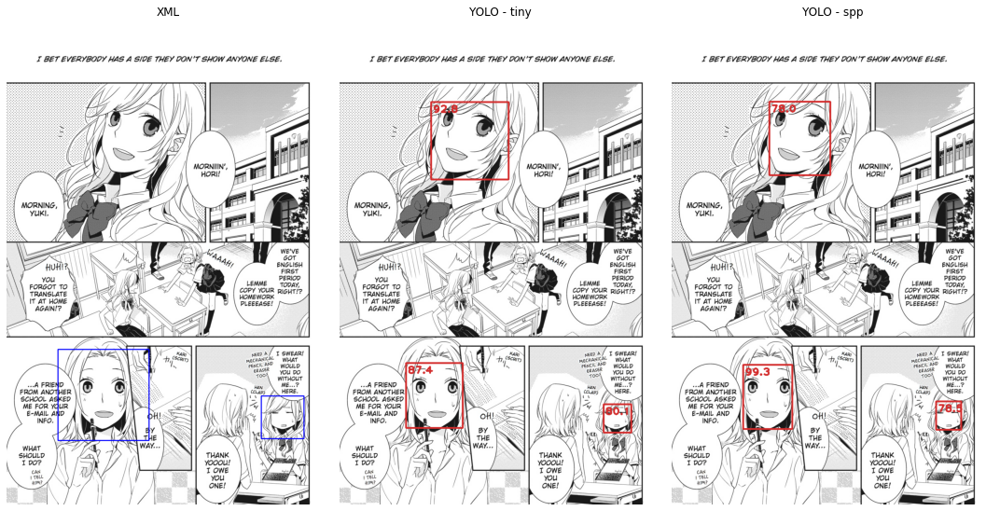

<Figure size 5760x2880 with 0 Axes>

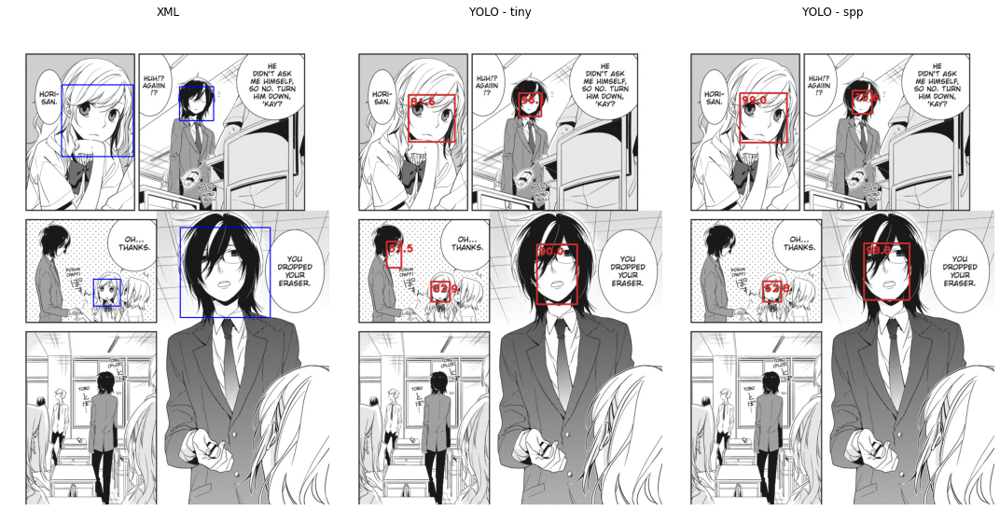

<Figure size 5760x2880 with 0 Axes>

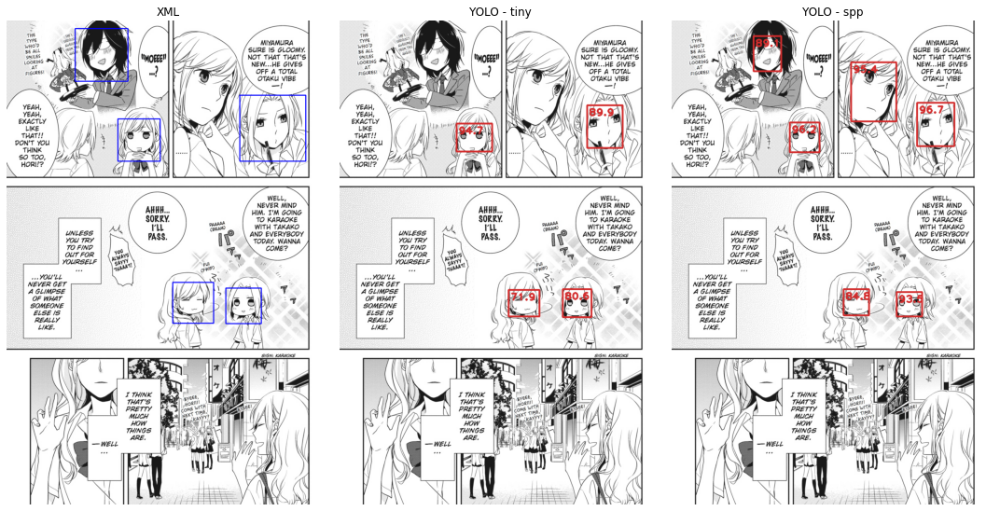

<Figure size 5760x2880 with 0 Axes>

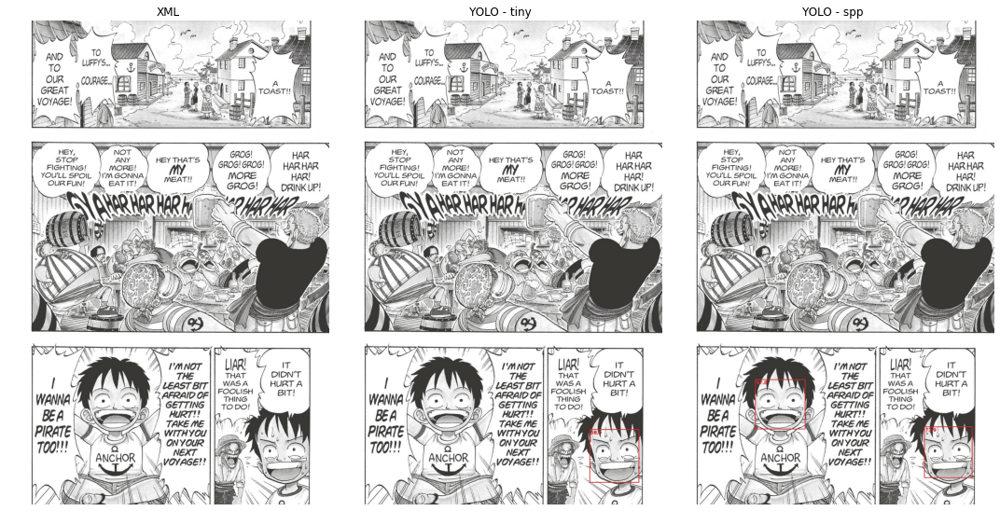

<Figure size 5760x2880 with 0 Axes>

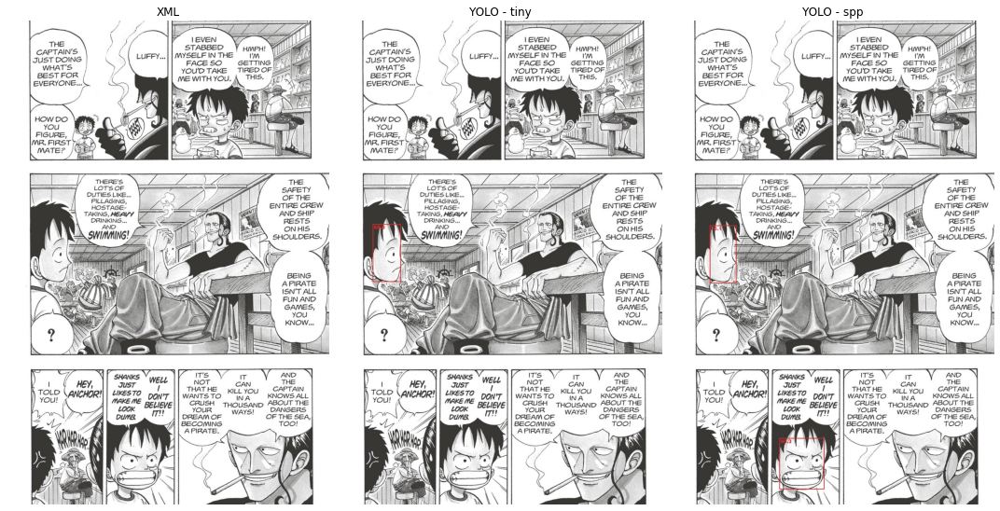

<Figure size 5760x2880 with 0 Axes>

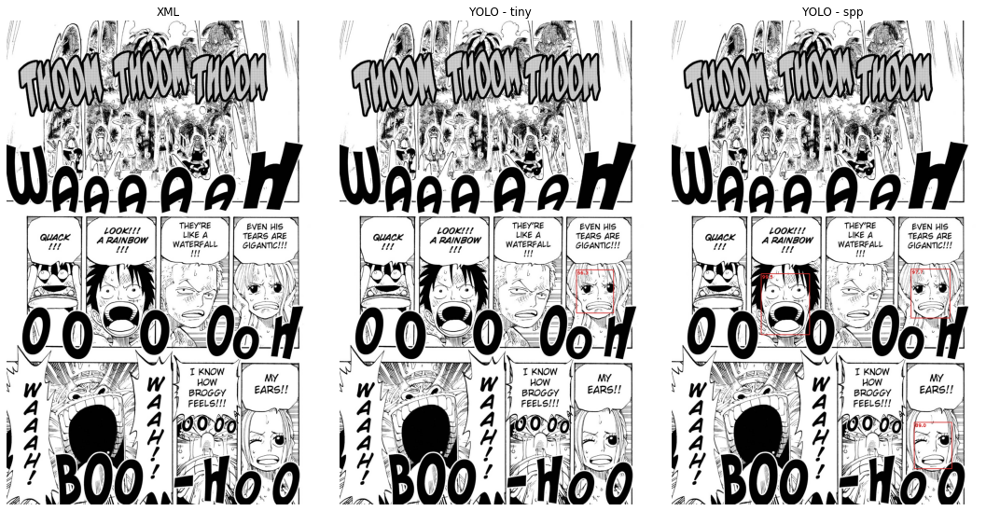

In [8]:
directory = config.volumes_dir
files = os.listdir(directory)

print("Which volume of manga would you like to use detection on?")
for i in range(0, len(files)):
    print(f" \t {i}. {files[i]}")

chosen_volume = input()
chosen_directory = directory + "\\" + str(files[int(chosen_volume)])

for file in range(len(os.listdir(chosen_directory))):
    image_xml = detect(os.listdir(chosen_directory)[file],os.listdir(chosen_directory), chosen_directory)
    image_yolo_spp = detect_yolo_spp(os.listdir(chosen_directory)[file], os.listdir(chosen_directory), chosen_directory)
    image_yolo_tiny = detect_yolo_tiny(os.listdir(chosen_directory)[file], os.listdir(chosen_directory), chosen_directory)

    plt.figure(figsize=(80,40))
    f, axarr = plt.subplots(1,3) 
    f.set_figheight(15)
    f.set_figwidth(15)

    axarr[0].set_axis_off()
    axarr[0].set_title("XML")
    axarr[0].imshow(image_xml)
    axarr[1].set_axis_off()
    axarr[1].set_title("YOLO - tiny")
    axarr[1].imshow(image_yolo_tiny)
    axarr[2].set_axis_off()
    axarr[2].set_title("YOLO - spp")
    axarr[2].imshow(image_yolo_spp)

    
    f.tight_layout()
    f.subplots_adjust(top=0.88)

    plt.show()

## Recognition

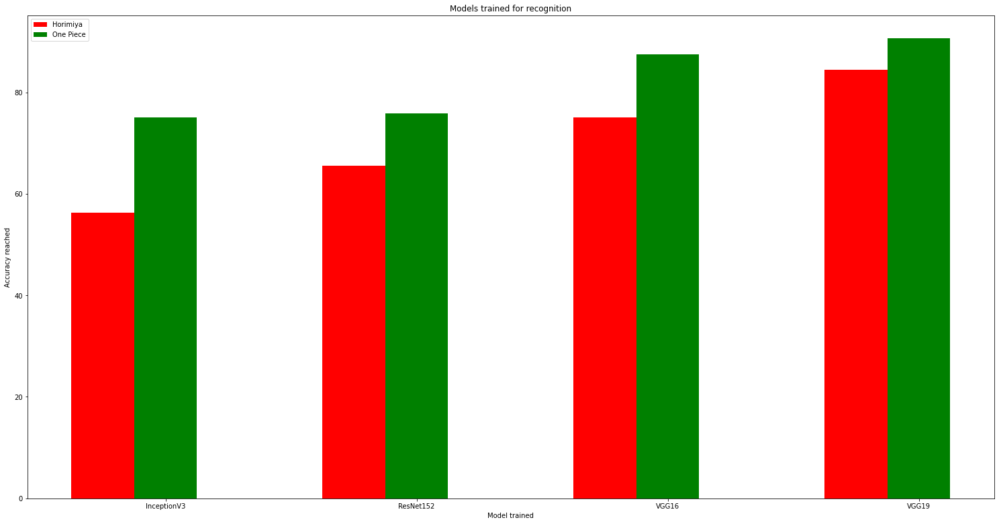

In [6]:
import numpy as np
import matplotlib.pyplot as plt
barWidth = 0.25
data = [[56.25, 65.52, 75, 84.38],
[75, 75.8, 87.5, 90.63]]
X = np.arange(4)
Series = ["Horimiya", "One Piece"]
fig = plt.figure(figsize=(20,10))
ax = fig.add_axes([0,0,1,1])
ax.bar(X + 0.00, data[0], color = 'r', width = 0.25)
ax.bar(X + 0.25, data[1], color = 'g', width = 0.25)
plt.xticks([r + barWidth for r in range(len(data[0]))], 
           ['InceptionV3', 'ResNet152', 'VGG16', 'VGG19']) 
plt.title("Models trained for recognition")
plt.xlabel("Model trained")
plt.ylabel("Accuracy reached")
plt.legend(Series,loc=2)
plt.show() 

In [5]:
import cv2
import os
import config
import math
import numpy as np
import tensorflow as tf
from tensorflow import keras
from PIL import Image, ImageFont, ImageDraw  
import skimage.data
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import selectivesearch
from skimage.io import imread, imsave, imshow
from skimage import data, color, io, filters, morphology,transform, exposure, feature, util

from keras.models import load_model 
from keras.preprocessing import image
from keras.preprocessing.image import img_to_array, load_img


###### Voor Tensorflow-GPU ########
physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)
tf.config.experimental.set_memory_growth(physical_devices[0], True)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [6]:
# Getting all the classes in dataset
directory = 'Original_dataset_horimiya'
classes_recog = os.listdir(directory)
try:
    classes_recog.remove('Readme.md')
    print(classes_recog)
except:
    print('No readme found')

model_recog = keras.models.load_model(r"Weights_recog/Final_Model_VGG19_horimiya.h5")


['Ayasaki', 'Hori', 'Ishikawa', 'Kouno', 'Miyamura', 'Sengoku', 'Unknown', 'Yoshikawa']


In [7]:
# Getting all the classes in dataset
directory = 'Original_dataset_onepiece'
classes_recog = os.listdir(directory)
try:
    classes_recog.remove('Readme.md')
    print(classes_recog)
except:
    print('No readme found')

model_recog = keras.models.load_model(r"Weights_recog/Final_Model_VGG19_onepiece.h5")


No readme found


In [8]:
# Yolo model inladen en klaarzetten voor gebruik
net = cv2.dnn.readNet("Weights_detec\manga_v7_final_weights.weights", "Weights_detec\manga_v7_final_config.cfg")  

layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]

# Namen van de classes definiëren (volgorde is zeer belangrijk)
classes = ["RandomFrame", "Face", "Text"]

def drawboxes(file, files, directory):
    j = 0
    # Reading and preprocessing the page of the volume.
    img = cv2.imread(directory + "/" +  file)
    img = np.array(img)
    stacked_img = np.stack((img,)*3, axis=-1)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)

    # Creating variables, incrementing J for saving images.
    class_ids, confidences, boxes = [], [], []
        
    j += 1

    image = Image.fromarray(img)
    # For every detection in each page.
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.2:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    # boxes tekenen
    for i in range(len(boxes)):
           
        if i in indexes:
            x, y, w, h = boxes[i]
            confidence = round(confidences[i] * 100, 1)
            label = str(classes[int(class_ids[i])])

            # Drawing the rectangle with an accuracy inside of it.
            cv2.rectangle(img, (x, y), (x + w, y + h), color=(211, 44, 44), thickness=3)
            cv2.putText(img, str(confidence), (x + 5, y + 30), cv2.FONT_HERSHEY_PLAIN, 1.4, color=(211, 44, 44), thickness=4)

            # This image will be used to predict which character is present.
            # So this image will be put into the recognition model.
            image2 = image.crop((x, y, x+w, y+h))

            image2.save("0.jpg")

            image2 = load_img("0.jpg", target_size=(224,224))

            numpyImage = img_to_array(image2)

            numpyImage /= 255

            numpyImage = numpyImage.reshape((1,224,224,3))

            pred = model_recog.predict(numpyImage)

            pred_location = np.argmax(pred[0])

            pred_value = pred[0][pred_location]

            if pred_value >= 0.8:
                pred_chara = classes_recog[np.argmax(pred[0])]
            elif pred_value < 0.8:
                pred_chara = "Unknown"

            cv2.putText(img, str(pred_chara), (x + 5, y - 10), cv2.FONT_HERSHEY_PLAIN, 1.5, color=(211, 44, 44), thickness=3)
                
    # Saving the image to a results folder.
    image = Image.fromarray(img)
    return image
    # image.save(f"Results/{volume_name}/{j}.jpg")

Which volume of manga would you like to use detection on?
 	 0. - Demo Showcase detection -
 	 1. - Demo Showcase recognition horimiya -
 	 2. - Demo Showcase recognition onepiece -
 	 3. Beastars v01
 	 4. Blue Spring Ride - Volume 02.cbz.zip
 	 5. Blue Spring Ride - Volume 03.cbz.zip
 	 6. Blue Spring Ride - Volume 04.cbz.zip
 	 7. Horimiya v01 (2015) (Digital) (LuCaZ).cbz.zip
 	 8. Horimiya v02 (2016) (Digital) (LuCaZ).cbz.zip
 	 9. Horimiya v03 (2016) (Digital) (LuCaZ).cbz.zip
 	 10. Horimiya v04 (2016) (Digital) (LuCaZ).cbz.zip
 	 11. Horimiya v05 (2016) (Digital) (LuCaZ).cbz.zip
 	 12. Horimiya v06 (2017) (Digital) (LuCaZ).cbz.zip
 	 13. Horimiya v07 (2017) (Digital) (LuCaZ).cbz.zip
 	 14. Horimiya v08 (2017) (Digital) (LuCaZ).cbz.zip
 	 15. Horimiya v09 (2017) (Digital) (LuCaZ).cbz.zip
 	 16. Horimiya v10 (2018) (Digital) (LuCaZ).cbz.zip
 	 17. One Piece 01.cbz.zip
 	 18. One Piece 02.cbz.zip
 	 19. One Piece 03.cbz.zip
 	 20. One Piece 04.cbz.zip
 	 21. One Piece 05.cbz.zip
 	 

<Figure size 5760x2880 with 0 Axes>

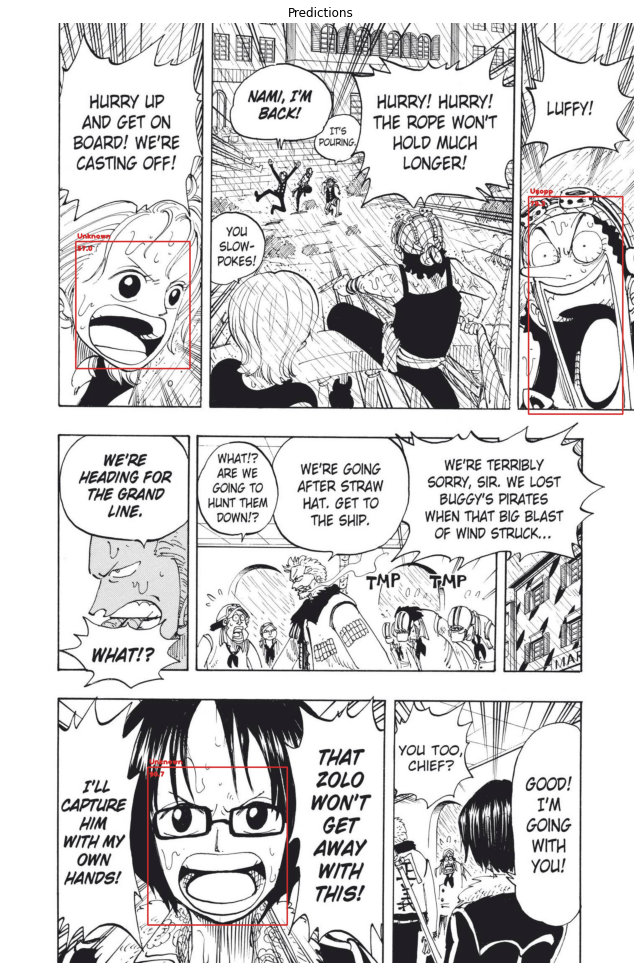

<Figure size 5760x2880 with 0 Axes>

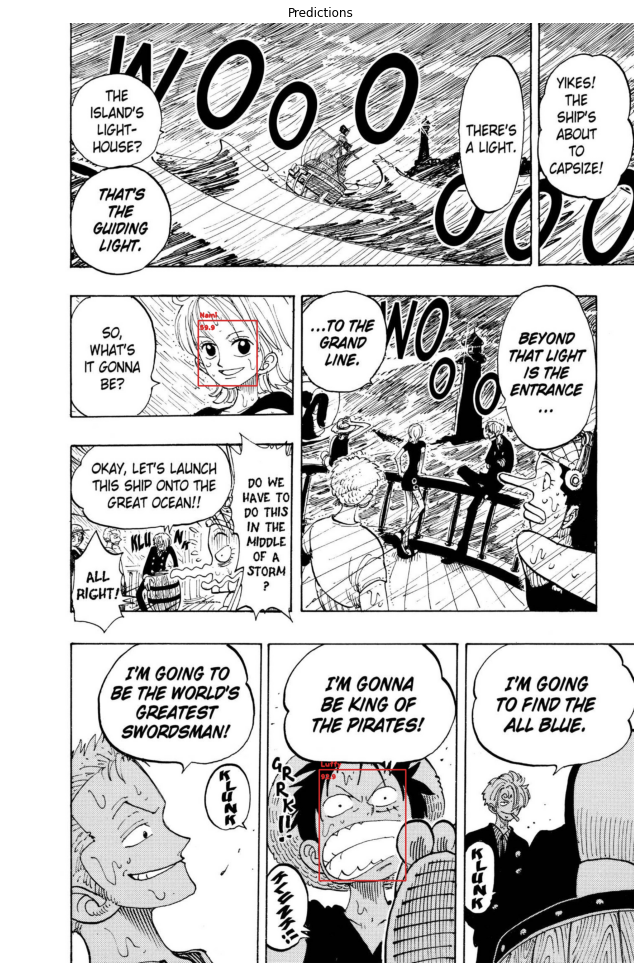

<Figure size 5760x2880 with 0 Axes>

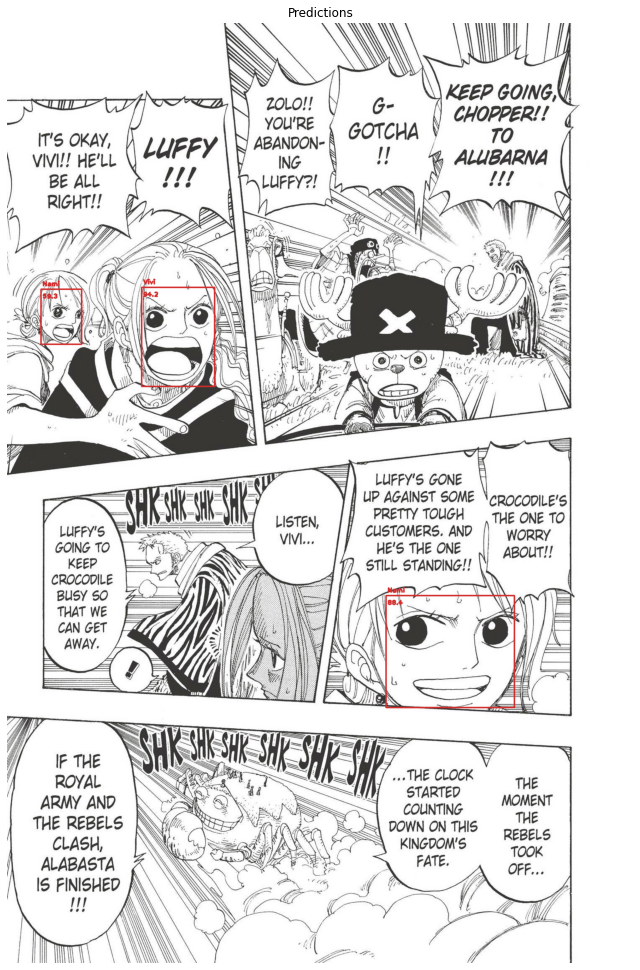

<Figure size 5760x2880 with 0 Axes>

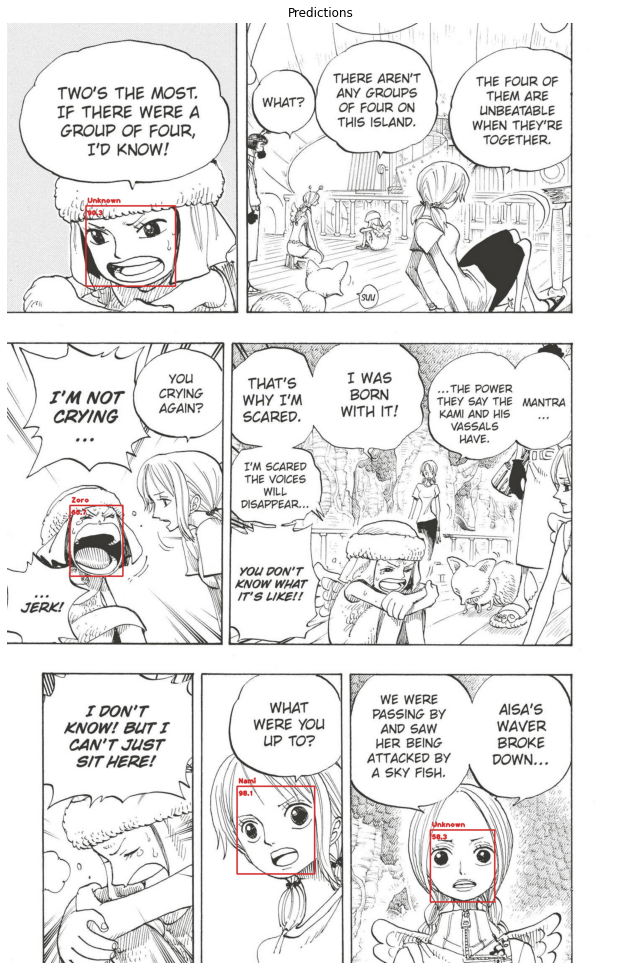

<Figure size 5760x2880 with 0 Axes>

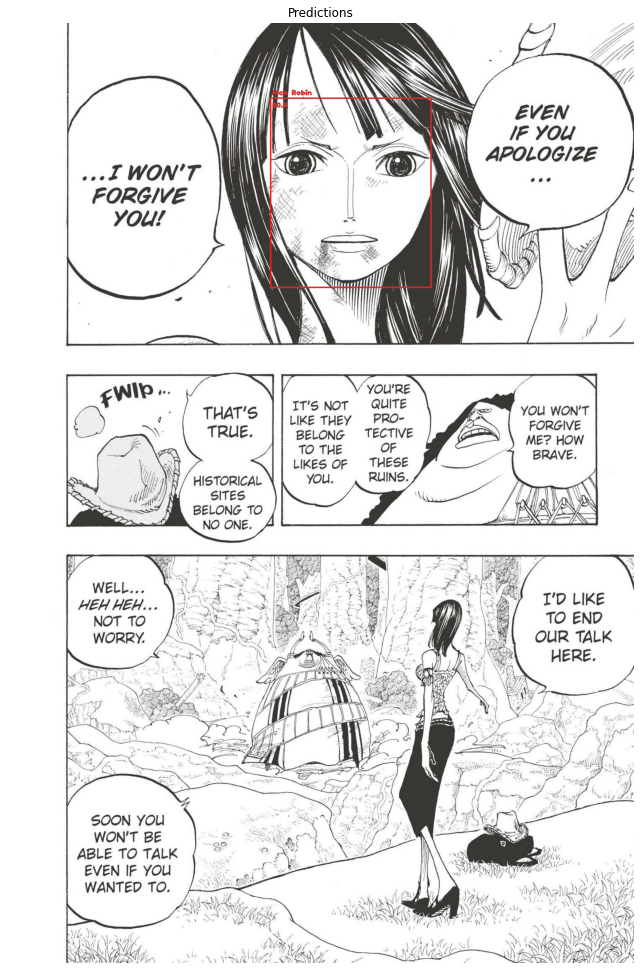

In [9]:
directory = config.volumes_dir
files = os.listdir(directory)
chosen_volume = 0


print("Which volume of manga would you like to use detection on?")
for i in range(0, len(files)):
    print(f" \t {i}. {files[i]}")
chosen_volume = input("Which volume of manga would you like to use detection on? ")
chosen_directory = directory + "\\" + str(files[int(chosen_volume)])

for file in range(len(os.listdir(chosen_directory))):
    image = drawboxes(os.listdir(chosen_directory)[file], os.listdir(chosen_directory), chosen_directory)

    plt.figure(figsize=(80,40))
    f, axarr = plt.subplots(1,1) 
    f.set_figheight(15)
    f.set_figwidth(15)

    axarr.set_axis_off()
    axarr.set_title("Predictions")
    axarr.imshow(image)

    f.tight_layout()
    f.subplots_adjust(top=0.88)

    plt.show()